In [6]:
import sys
import os
import numpy as np
import torch
from torch.utils.data import DataLoader
import torch.nn.functional as F
from IPython.display import HTML
sys.path.append(os.path.abspath(os.path.join(os.path.dirname("__file__"), '..')))
from datasets.Waymo import WaymoDataset, waymo_collate_fn, get_world_coordinates
from model.layers.ODE import ODE
from visualize import render_observed_scene_state, render_flow_field

In [7]:
tfrecord_path = '../../data1/waymo_dataset/uncompressed/tf_example/validation'
idx_path = '../../idx/validation'
dataset = WaymoDataset(tfrecord_path, idx_path)
dataloader = DataLoader(dataset, batch_size=1, collate_fn=lambda x: waymo_collate_fn(x))
road_map, agent_trajectories, unobserved_positions, future_times, target_velocity, agent_mask, flow_field_mask = next(iter(dataloader))

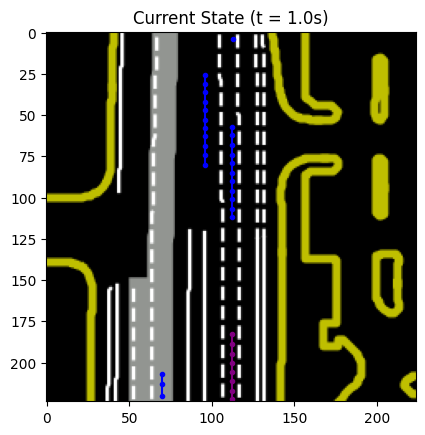

In [8]:
render_observed_scene_state(road_map[0], agent_trajectories[0])

In [9]:
anim = render_flow_field(road_map[0], future_times[0] , unobserved_positions[0], target_velocity[0])
HTML(anim.to_jshtml())

In [5]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(device)

cuda


In [6]:
p = unobserved_positions[0].to(device)
t = future_times[0].to(device)
v = target_velocity[0].to(device)

flow_field = ODE(2, 0, (256 for _ in range(4)), 128).to(device)
flow_field.train()

optim = torch.optim.Adam(flow_field.parameters(), lr=1e-3, weight_decay=0)
scheduler = torch.optim.lr_scheduler.ExponentialLR(optim, gamma=0.999)

EPOCHS = 1000
for epoch in range(EPOCHS):
    flow = flow_field(t, p, None)
    loss = F.mse_loss(flow, v)
    if epoch == 0 or (epoch + 1) % 100 == 0:
            print(f'Epoch {epoch+1}, Loss: {loss}')

    optim.zero_grad()
    loss.backward()
    optim.step()
    scheduler.step()

Epoch 1, Loss: 55.56847381591797
Epoch 100, Loss: 31.369916915893555
Epoch 200, Loss: 5.623406410217285
Epoch 300, Loss: 0.5899312496185303
Epoch 400, Loss: 0.2549896538257599
Epoch 500, Loss: 0.13298428058624268
Epoch 600, Loss: 0.09618961811065674
Epoch 700, Loss: 0.08019888401031494
Epoch 800, Loss: 0.06528933346271515
Epoch 900, Loss: 0.05088631063699722
Epoch 1000, Loss: 0.041514672338962555


In [7]:
estimated_velocity = flow_field(t, p, None)
anim = render_flow_field(road_map[0], future_times[0], unobserved_positions[0], estimated_velocity.detach().cpu())
HTML(anim.to_jshtml())

In [8]:
GRID_SIZE = road_map[0].shape[0]
STRIDE = 10
TIMESTEPS = 80
FREQ = 10

y_coords = np.arange(0, GRID_SIZE, STRIDE)
x_coords = np.arange(0, GRID_SIZE, STRIDE)
grid_x, grid_y = np.meshgrid(x_coords, y_coords)
grid_points = np.column_stack((grid_x.flatten(), grid_y.flatten()))
grid_points = get_world_coordinates(grid_points)
grid_points = torch.FloatTensor(grid_points)

num_cells = grid_points.shape[0]

grid_points = grid_points.repeat(TIMESTEPS, 1)
grid_points = grid_points.reshape(-1, 2).to(device)

grid_times = [1.1 + t / FREQ for t in range(TIMESTEPS)]
grid_times = torch.FloatTensor(grid_times)
grid_times = grid_times.repeat_interleave(num_cells).unsqueeze(-1).to(device)

In [9]:
grid_estimated_velocity = flow_field(grid_times, grid_points, None)
anim = render_flow_field(road_map[0], grid_times.cpu(), grid_points.cpu(), grid_estimated_velocity.detach().cpu())
HTML(anim.to_jshtml())